<a href="https://colab.research.google.com/github/ussnllmn/Deep_Learning/blob/main/Test4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [8]:
''' IMPORT ALL THE THINGS '''
import os
import matplotlib.pyplot as plt
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg19 import VGG19
import pandas as pd

In [9]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [10]:
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


In [11]:
''' DEFINE PATH TO THE DATASETS '''

'''CWD = os.getcwd().replace('\\','/') # get current workspace directory
IMAGE_DIR = f'{CWD}/images'
TRAIN_DATASET_DIR = f'{IMAGE_DIR}/train'
TEST_DATASET_DIR = f'{IMAGE_DIR}/test'
VAL_DATASET_DIR = f'{IMAGE_DIR}/validation'

CATEGORIES = ['clementine','grapefruit','orange']'''

# print('CWD :',CWD)
# print('IMAGE_DIR :',IMAGE_DIR)
# print('TRAIN_DATASET_DIR :',TRAIN_DATASET_DIR)
# print('TEST_DATASET_DIR :',TEST_DATASET_DIR)
# print('VAL_DATASET_DIR :',VAL_DATASET_DIR)
# print('CATEGORIES :', CATEGORIES)

"CWD = os.getcwd().replace('\\','/') # get current workspace directory\nIMAGE_DIR = f'{CWD}/images'\nTRAIN_DATASET_DIR = f'{IMAGE_DIR}/train'\nTEST_DATASET_DIR = f'{IMAGE_DIR}/test'\nVAL_DATASET_DIR = f'{IMAGE_DIR}/validation'\n\nCATEGORIES = ['clementine','grapefruit','orange']"

**กำหนด path ใหม่ เพราะ run จาก machine บน google colab**

In [12]:
train = ImageDataGenerator(rescale= 1/255)
validation = ImageDataGenerator(rescale= 1/255)

In [13]:
train_dataset = train.flow_from_directory("/content/drive/MyDrive/dataset/Images_of_Waste/train",
                                          target_size=(224,224),
                                          batch_size = 3,
                                          class_mode ="categorical")

validation_dataset = validation.flow_from_directory("/content/drive/MyDrive/dataset/Images_of_Waste/valid",
                                          target_size=(224,224),
                                          batch_size = 3,
                                          class_mode ="categorical")

Found 2677 images belonging to 3 classes.
Found 799 images belonging to 3 classes.


In [14]:
train_dataset.class_indices

{'AluCan': 0, 'Glass': 1, 'PET': 2}

In [15]:
validation_dataset.class_indices

{'Alucan': 0, 'Glass': 1, 'PET': 2}

In [16]:
''' Create Augmented Data '''

' Create Augmented Data '

In [17]:
''' Get pre train model '''
VGG = VGG16(input_shape=(224, 224, 3), include_top=False, weights='imagenet')
VGG.trainable = False

58900480/58889256 [==============================] - 0s 0us/step


In [18]:
''' Create a model '''
model = tf.keras.models.Sequential([
                                    VGG,
                                    tf.keras.layers.Flatten(),
                                    tf.keras.layers.Dense(512, activation='relu'),
                                    tf.keras.layers.Dense(512, activation='relu'),
                                    tf.keras.layers.Dense(3, activation='softmax')
])

In [19]:
model.summary() # show all the model's layer

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten (Flatten)            (None, 25088)             0         
_________________________________________________________________
dense (Dense)                (None, 512)               12845568  
_________________________________________________________________
dense_1 (Dense)              (None, 512)               262656    
_________________________________________________________________
dense_2 (Dense)              (None, 3)                 1539      
Total params: 27,824,451
Trainable params: 13,109,763
Non-trainable params: 14,714,688
_________________________________________________________________


In [20]:
''' Compiling '''

opt = tf.keras.optimizers.Adam(learning_rate=0.001) ### can be changed
los = tf.keras.losses.categorical_crossentropy  ### can be changed
  

model.compile(optimizer=opt, loss=los, metrics=['accuracy'])


In [27]:
''' Training '''
model.fit(
    train_dataset, # both data and label cause we use ImageDataGenerator
    
    epochs=30, ### can be change 
    validation_data= validation_dataset,
    
    shuffle=True 
)


Epoch 1/30
893/893 [==============================] - 36s 40ms/step - loss: 0.0713 - accuracy: 0.9768 - val_loss: 2.3639 - val_accuracy: 0.6433
Epoch 2/30
893/893 [==============================] - 35s 40ms/step - loss: 0.0984 - accuracy: 0.9694 - val_loss: 0.9216 - val_accuracy: 0.8060
Epoch 3/30
893/893 [==============================] - 36s 40ms/step - loss: 0.0329 - accuracy: 0.9888 - val_loss: 2.2586 - val_accuracy: 0.6546
Epoch 4/30
893/893 [==============================] - 35s 40ms/step - loss: 0.0459 - accuracy: 0.9847 - val_loss: 3.4973 - val_accuracy: 0.6333
Epoch 5/30
893/893 [==============================] - 35s 40ms/step - loss: 0.0364 - accuracy: 0.9869 - val_loss: 2.0983 - val_accuracy: 0.6921
Epoch 6/30
893/893 [==============================] - 35s 40ms/step - loss: 0.0417 - accuracy: 0.9858 - val_loss: 2.2871 - val_accuracy: 0.6809
Epoch 7/30
893/893 [==============================] - 35s 40ms/step - loss: 0.0304 - accuracy: 0.9933 - val_loss: 0.8135 - val_accuracy:

In [28]:
''' Evaluating '''
print(model.history.history.keys())

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


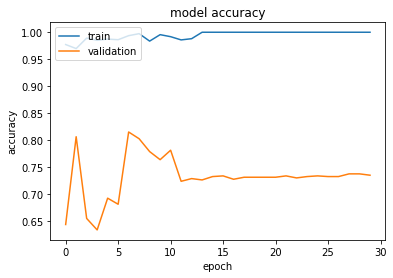

In [29]:
plt.plot(model.history.history['accuracy'])
plt.plot(model.history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

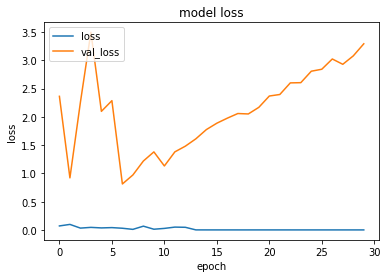

In [30]:
plt.plot(model.history.history['loss'])
plt.plot(model.history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['loss', 'val_loss'], loc='upper left')
plt.show()

In [31]:
''' Predicting '''


' Predicting '

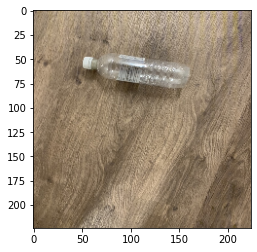

This isGlass : PET967.jpg


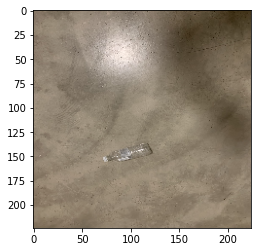

This isGlass : PET889.jpg


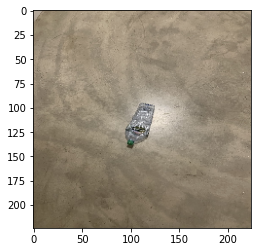

This isGlass : PET876.jpg


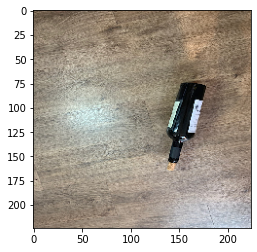

This isGlass : Glass978.JPG


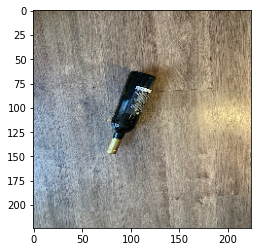

This isGlass : Glass872.JPG


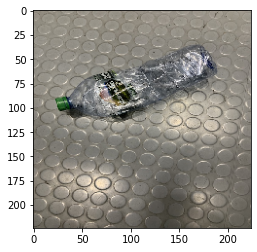

This isGlass : PET896.jpg


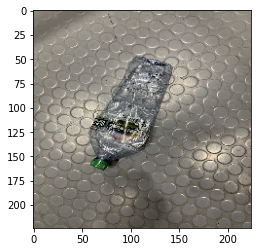

This isGlass : PET899.jpg


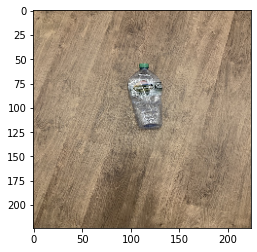

This isGlass : PET904.jpg


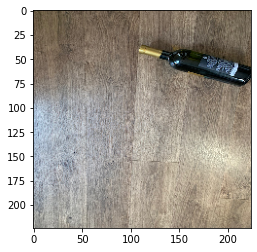

This isGlass : Glass890.JPG


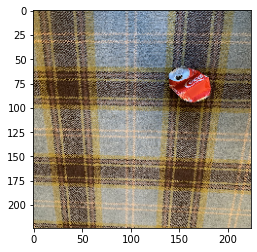

This is AluCan : AluCan984.jpg


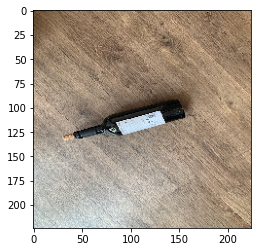

This isGlass : Glass963.JPG


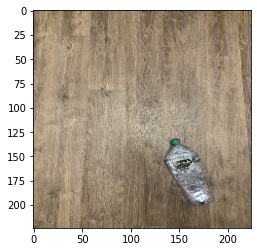

This isGlass : PET919.jpg


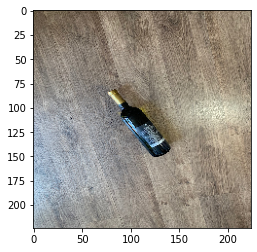

This isGlass : Glass887.JPG


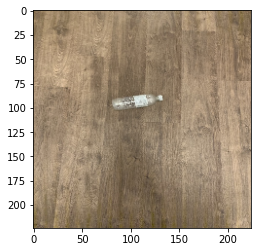

This isGlass : PET940.jpg


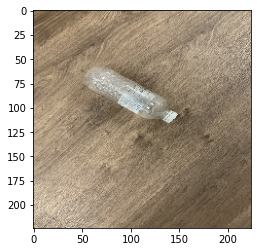

This isGlass : PET950.jpg


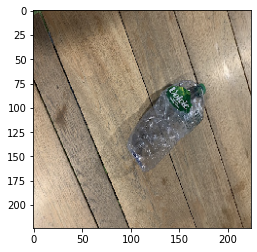

This is PET : PET848.jpg


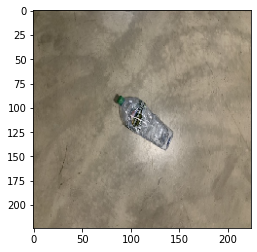

This isGlass : PET862.jpg


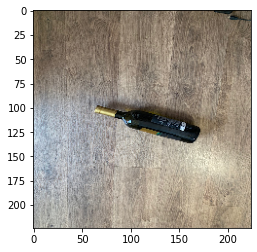

This isGlass : Glass888.JPG


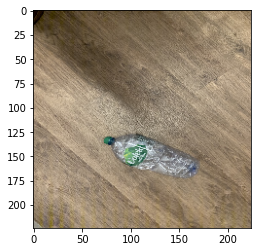

This isGlass : PET929.jpg


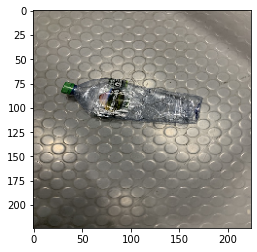

This isGlass : PET902.jpg


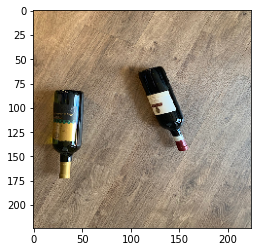

This isGlass : Glass945.JPG


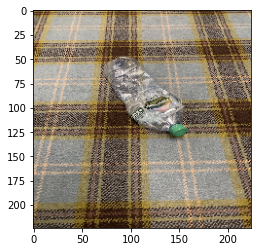

This is AluCan : PET987.jpg


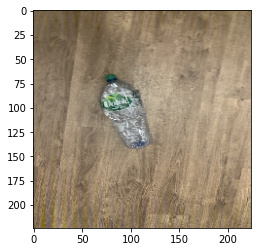

This is PET : PET927.jpg


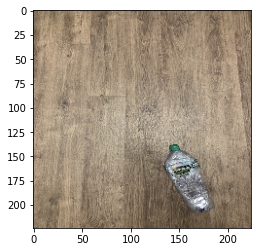

This isGlass : PET918.jpg


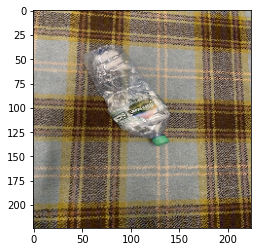

This is AluCan : PET998.jpg


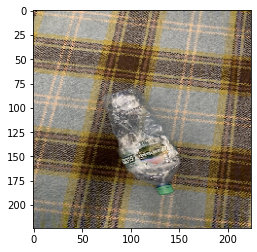

This is AluCan : PET993.jpg


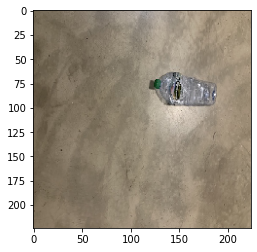

This isGlass : PET867.jpg


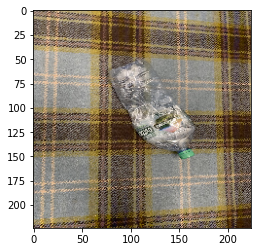

This is AluCan : PET997.jpg


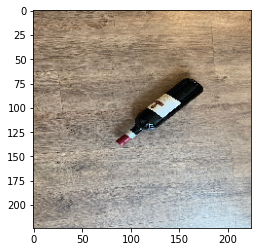

This isGlass : Glass907.JPG


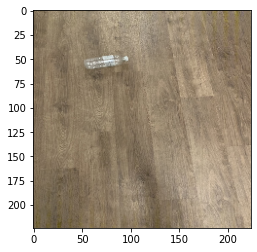

This isGlass : PET944.jpg


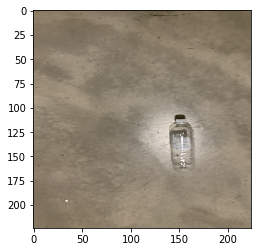

This isGlass : PET880.jpg


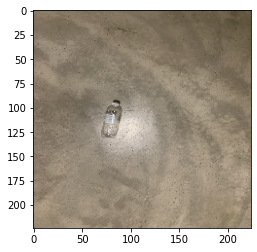

This isGlass : PET878.jpg


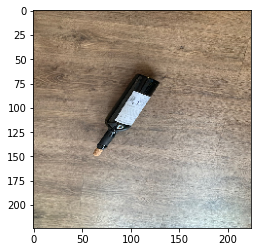

This isGlass : Glass966.JPG


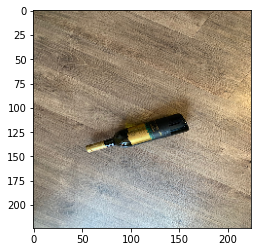

This isGlass : Glass935.JPG


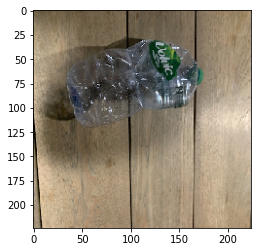

This is AluCan : PET857.jpg


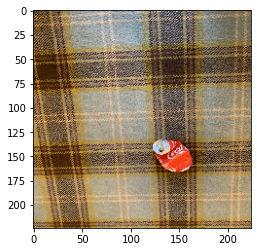

This is AluCan : AluCan965.jpg


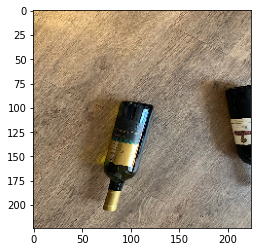

This isGlass : Glass946.JPG


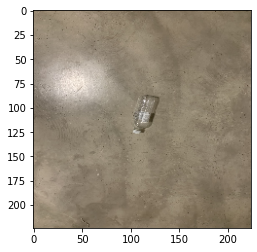

This isGlass : PET890.jpg


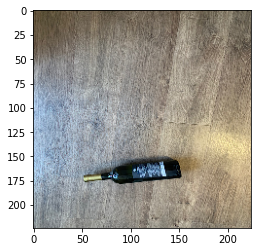

This isGlass : Glass876.JPG


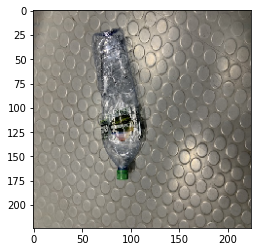

This isGlass : PET893.jpg


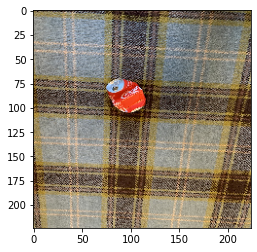

This is AluCan : AluCan985.jpg


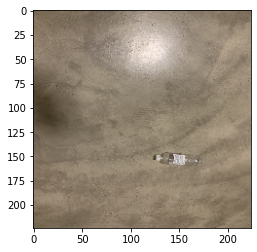

This isGlass : PET887.jpg


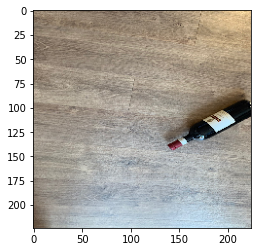

This isGlass : Glass911.JPG


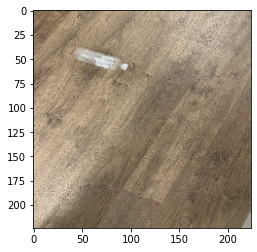

This isGlass : PET948.jpg


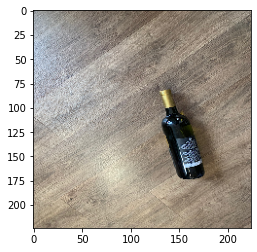

This isGlass : Glass883.JPG


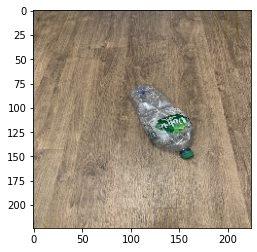

This isGlass : PET930.jpg


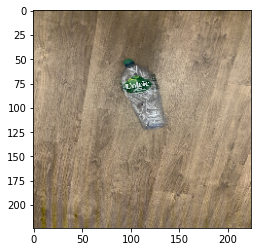

This is PET : PET925.jpg


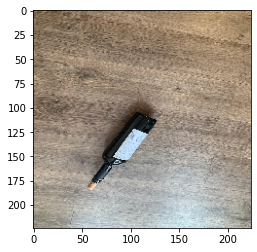

This isGlass : Glass965.JPG


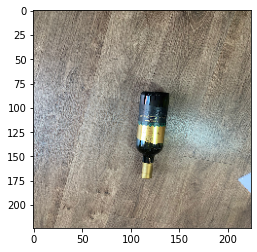

This isGlass : Glass895.JPG


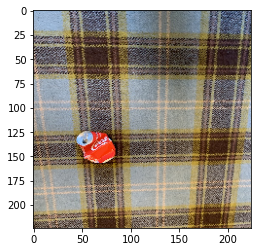

This is AluCan : AluCan977.jpg


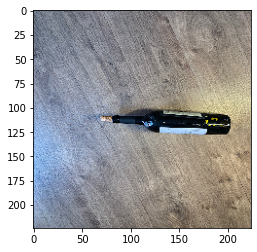

This isGlass : Glass956.JPG


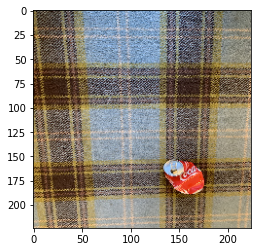

This is AluCan : AluCan979.jpg


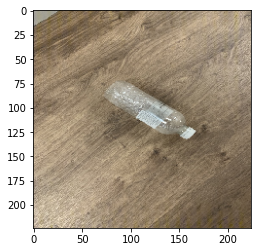

This isGlass : PET951.jpg


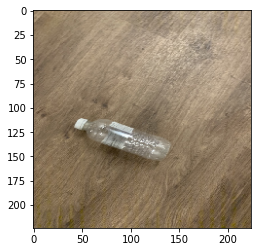

This isGlass : PET961.jpg


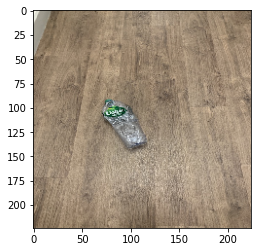

This isGlass : PET933.jpg


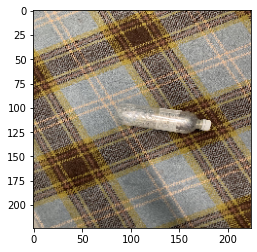

This isGlass : PET975.jpg


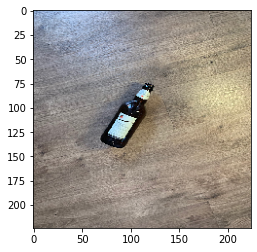

This isGlass : Glass998.JPG


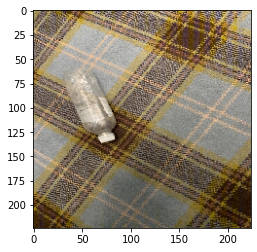

This isGlass : PET982.jpg


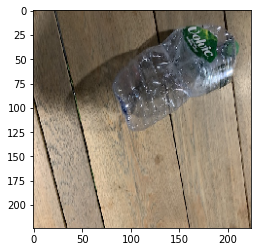

This is PET : PET853.jpg


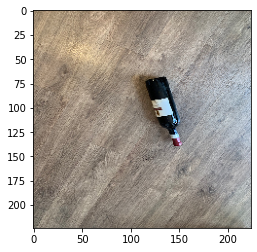

This isGlass : Glass917.JPG


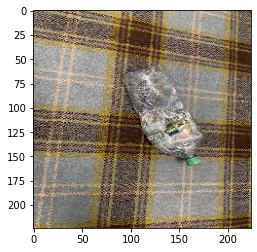

This is AluCan : PET996.jpg


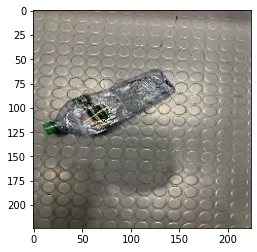

This isGlass : PET900.jpg


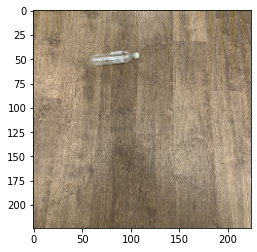

This isGlass : PET942.jpg


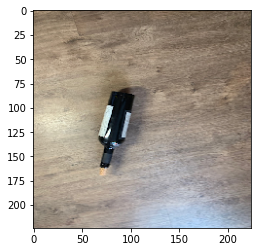

This isGlass : Glass984.JPG


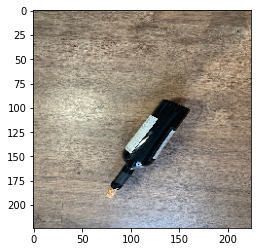

This isGlass : Glass988.JPG


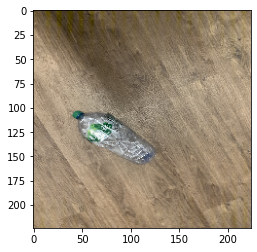

This isGlass : PET928.jpg


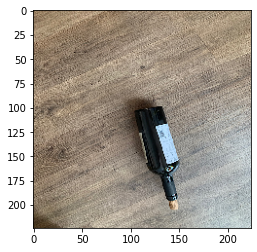

This isGlass : Glass962.JPG


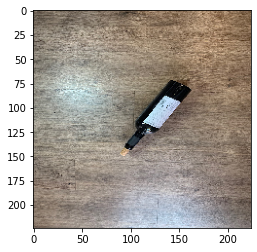

This isGlass : Glass973.JPG


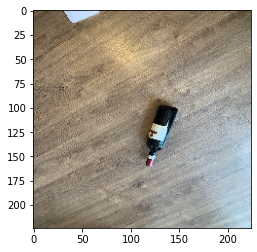

This isGlass : Glass923.JPG


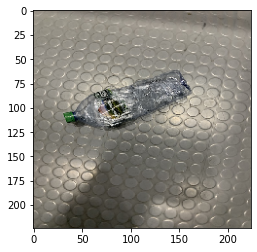

This isGlass : PET903.jpg


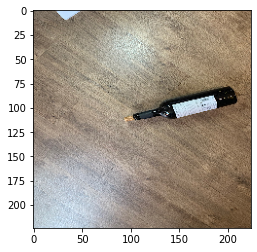

This isGlass : Glass971.JPG


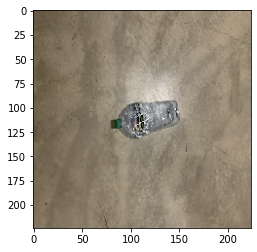

This isGlass : PET860.jpg


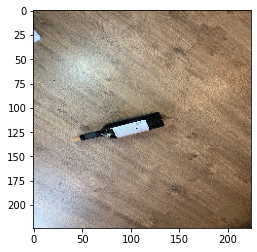

This isGlass : Glass970.JPG


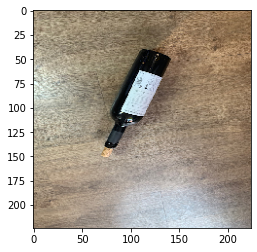

This isGlass : Glass967.JPG


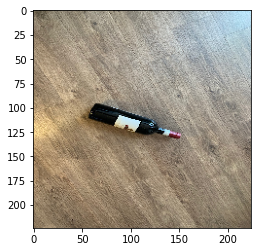

This isGlass : Glass928.JPG


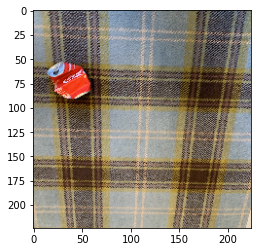

This is AluCan : AluCan975.jpg


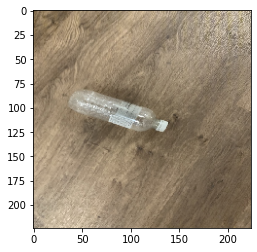

This isGlass : PET953.jpg


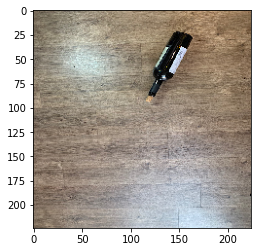

This isGlass : Glass952.JPG


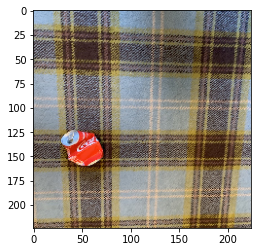

This is AluCan : AluCan987.jpg


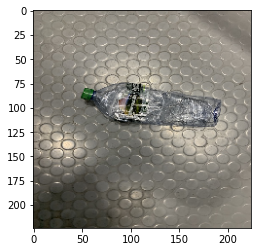

This isGlass : PET901.jpg


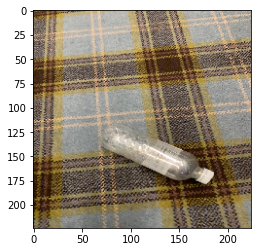

This isGlass : PET986.jpg


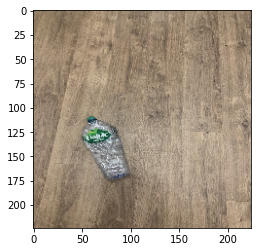

This isGlass : PET937.jpg


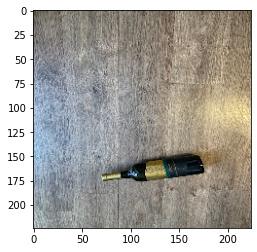

This isGlass : Glass874.JPG


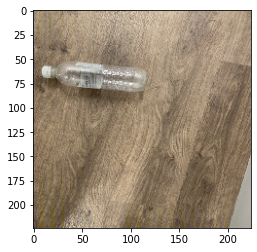

This isGlass : PET968.jpg


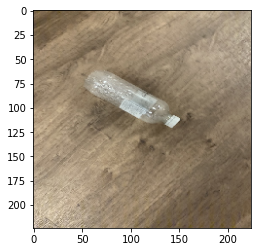

This isGlass : PET952.jpg


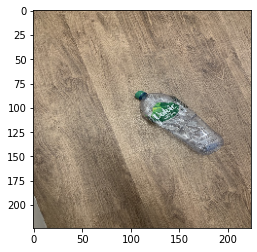

This isGlass : PET938.jpg


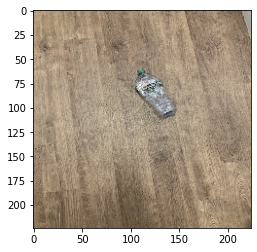

This isGlass : PET915.jpg


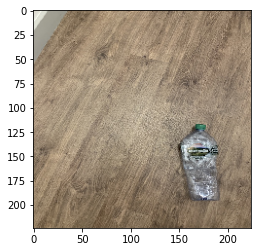

This isGlass : PET913.jpg


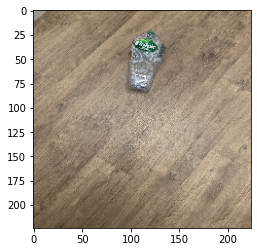

This isGlass : PET936.jpg


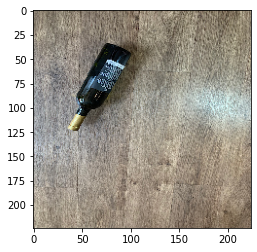

This isGlass : Glass882.JPG


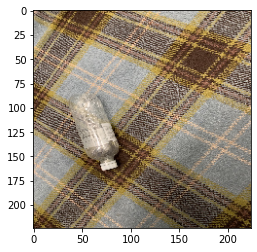

This isGlass : PET980.jpg


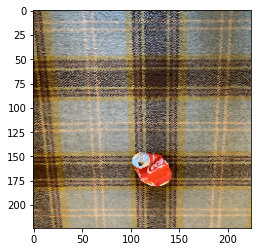

This is AluCan : AluCan966.jpg


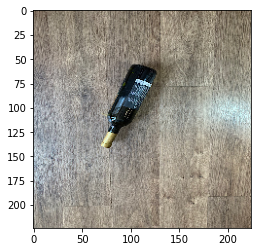

This isGlass : Glass881.JPG


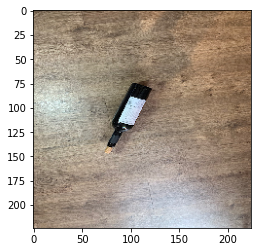

This isGlass : Glass968.JPG


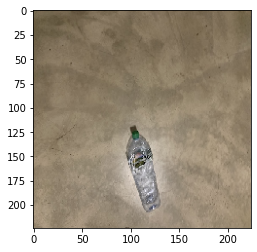

This isGlass : PET873.jpg


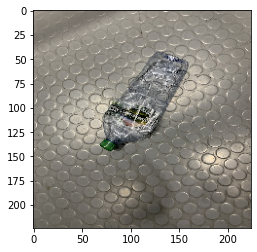

This isGlass : PET898.jpg


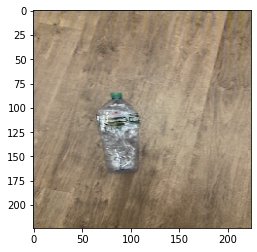

This isGlass : PET910.jpg


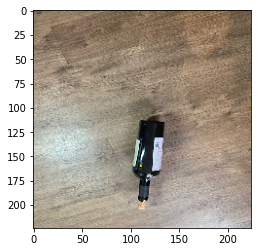

This isGlass : Glass979.JPG


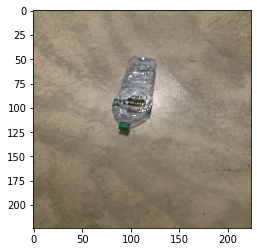

This isGlass : PET875.jpg


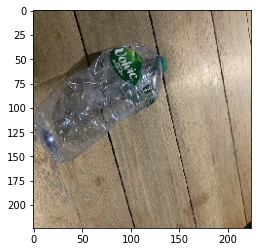

This is PET : PET849.jpg


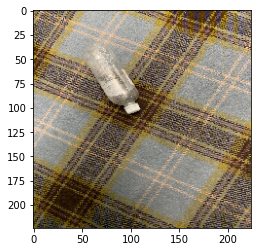

This isGlass : PET983.jpg


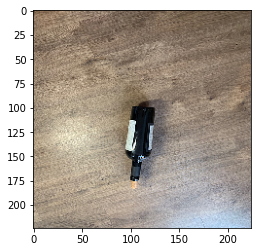

This isGlass : Glass983.JPG


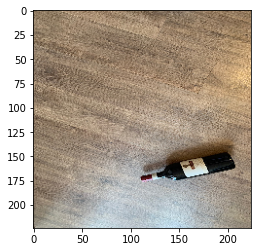

This isGlass : Glass919.JPG


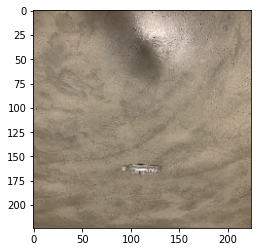

This isGlass : PET886.jpg


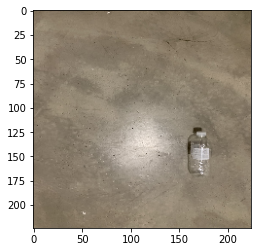

This isGlass : PET881.jpg


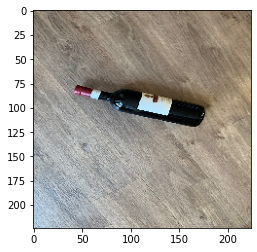

This isGlass : Glass910.JPG


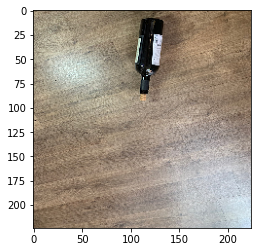

This isGlass : Glass980.JPG


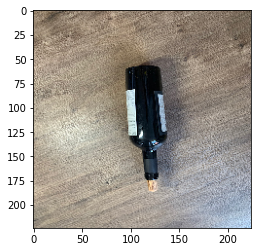

This isGlass : Glass992.JPG


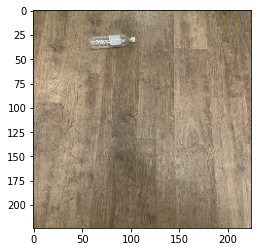

This isGlass : PET943.jpg


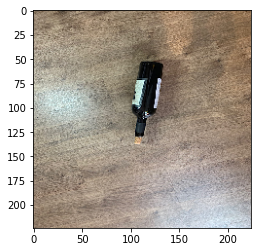

This isGlass : Glass975.JPG


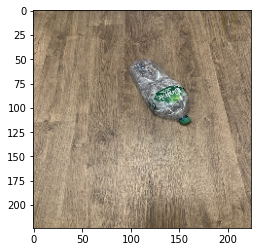

This isGlass : PET931.jpg


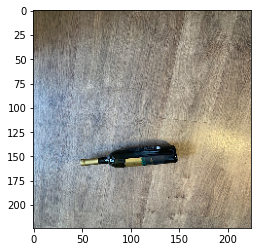

This isGlass : Glass877.JPG


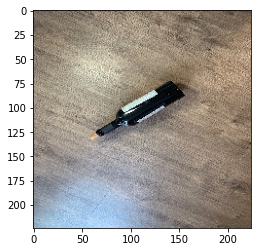

This isGlass : Glass989.JPG


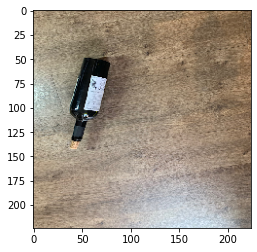

This isGlass : Glass976.JPG


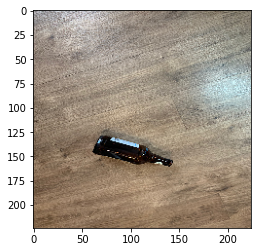

This isGlass : Glass996.JPG


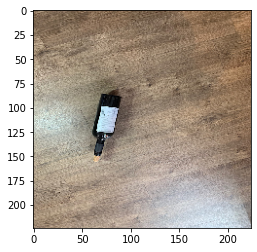

This isGlass : Glass969.JPG


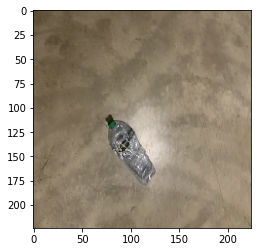

This isGlass : PET872.jpg


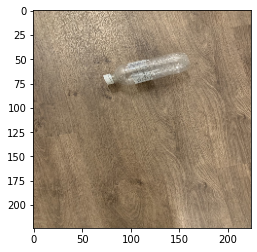

This isGlass : PET955.jpg


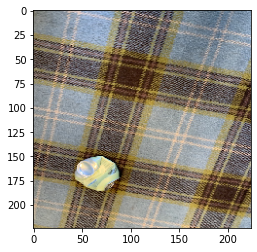

This is AluCan : AluCan964.jpg


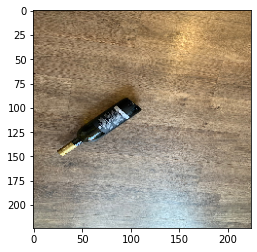

This isGlass : Glass938.JPG


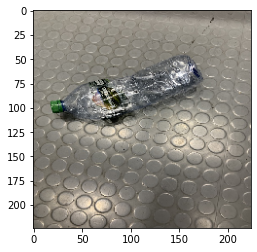

This isGlass : PET895.jpg


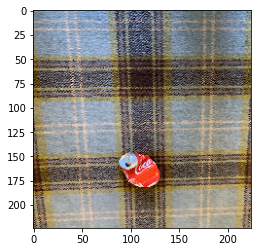

This is AluCan : AluCan989.jpg


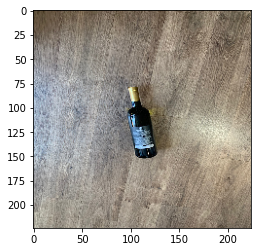

This isGlass : Glass885.JPG


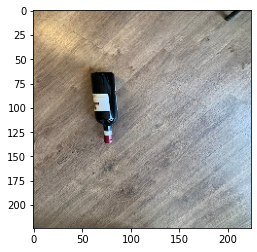

This isGlass : Glass924.JPG


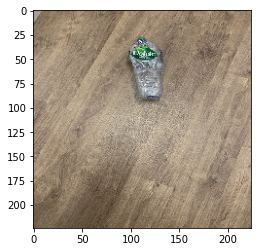

This isGlass : PET935.jpg


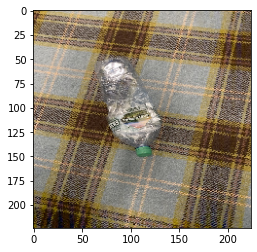

This isGlass : PET991.jpg


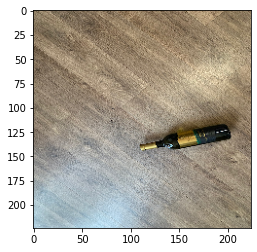

This isGlass : Glass903.JPG


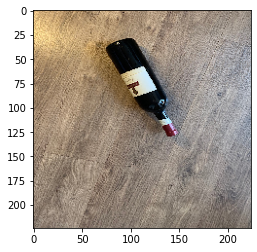

This isGlass : Glass914.JPG


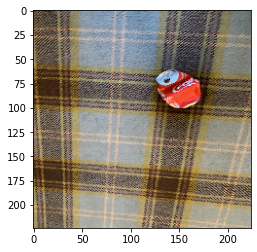

This is AluCan : AluCan971.jpg


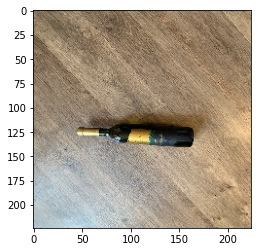

This isGlass : Glass899.JPG


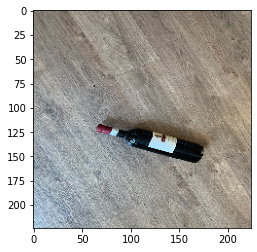

This isGlass : Glass909.JPG


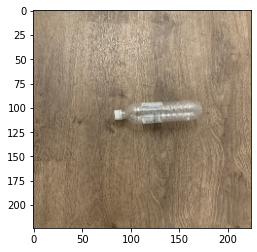

This isGlass : PET957.jpg


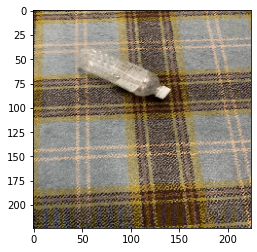

This isGlass : PET978.jpg


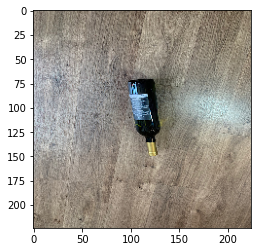

This isGlass : Glass898.JPG


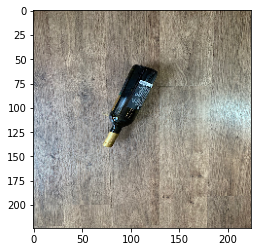

This isGlass : Glass880.JPG


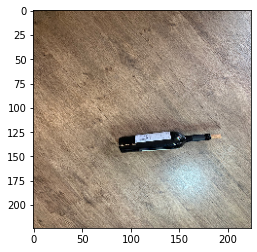

This isGlass : Glass953.JPG


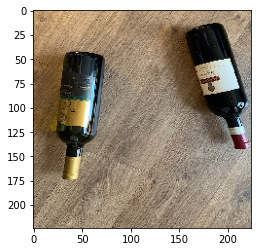

This isGlass : Glass944.JPG


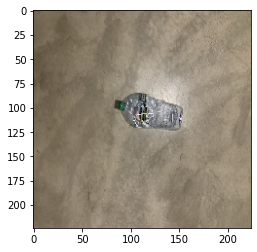

This isGlass : PET861.jpg


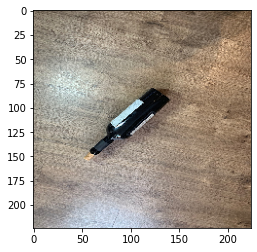

This isGlass : Glass986.JPG


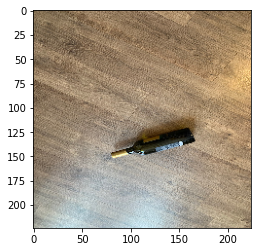

This isGlass : Glass937.JPG


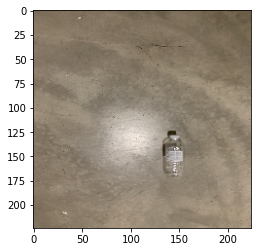

This isGlass : PET882.jpg


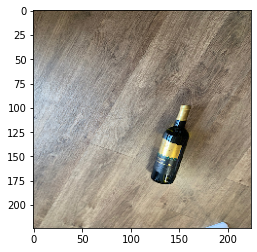

This isGlass : Glass884.JPG


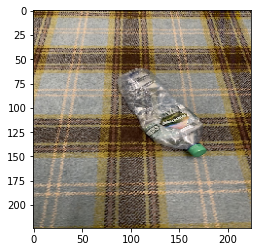

This is AluCan : PET989.jpg


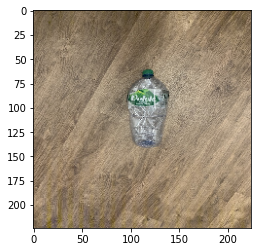

This isGlass : PET926.jpg


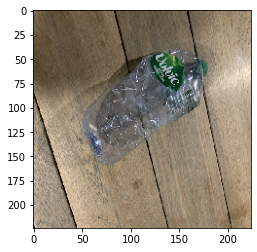

This is PET : PET850.jpg


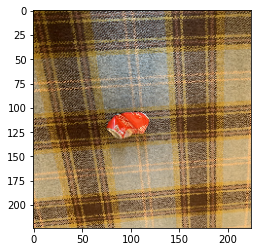

This is AluCan : AluCan990.jpg


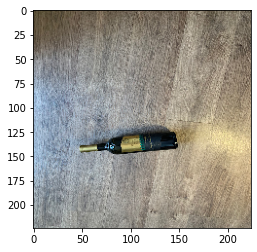

This isGlass : Glass878.JPG


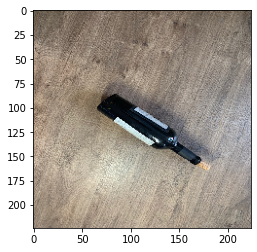

This isGlass : Glass991.JPG


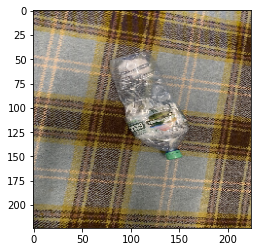

This is AluCan : PET995.jpg


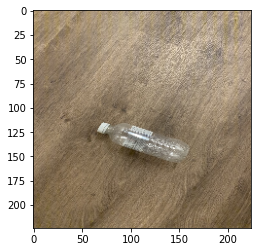

This isGlass : PET960.jpg


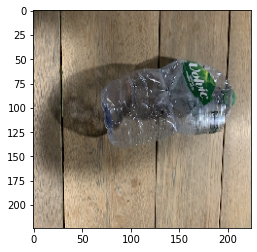

This is PET : PET858.jpg


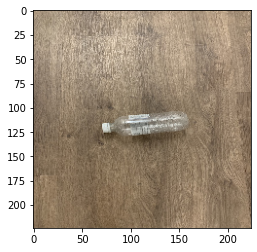

This isGlass : PET958.jpg


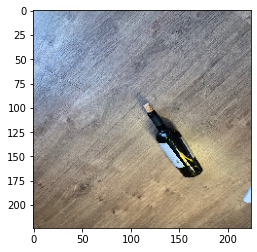

This isGlass : Glass957.JPG


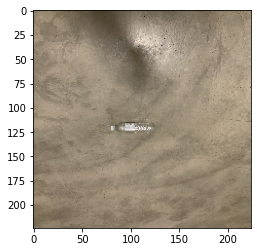

This isGlass : PET883.jpg


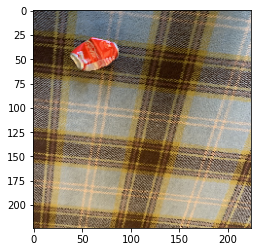

This is AluCan : AluCan999.jpg


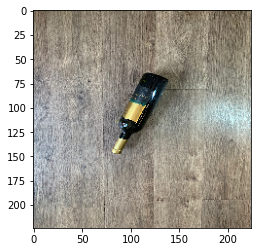

This isGlass : Glass879.JPG


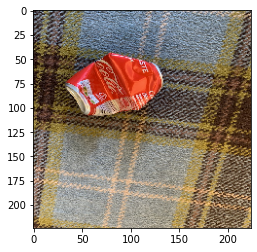

This is AluCan : AluCan994.jpg


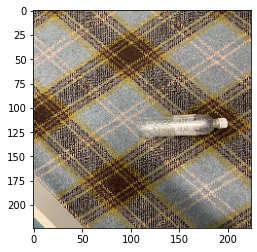

This isGlass : PET976.jpg


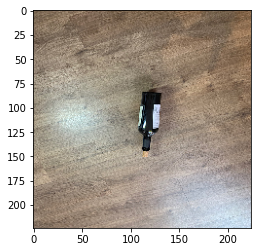

This isGlass : Glass981.JPG


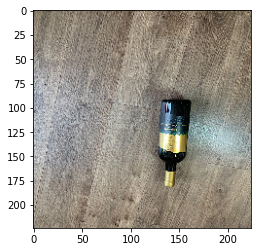

This isGlass : Glass896.JPG


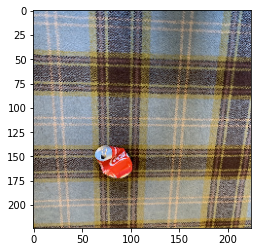

This is AluCan : AluCan978.jpg


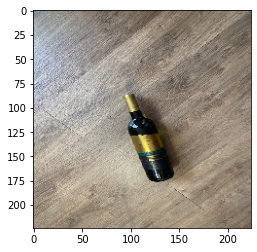

This isGlass : Glass906.JPG


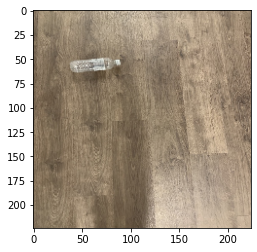

This isGlass : PET946.jpg


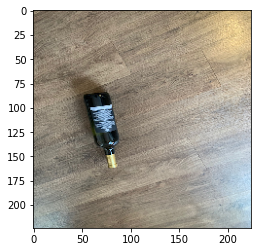

This isGlass : Glass934.JPG


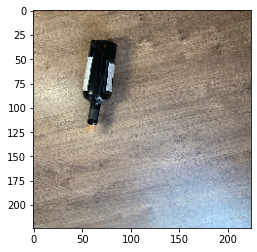

This isGlass : Glass993.JPG


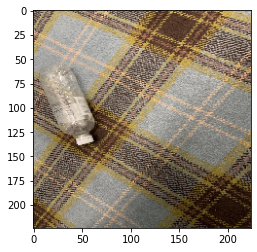

This isGlass : PET981.jpg


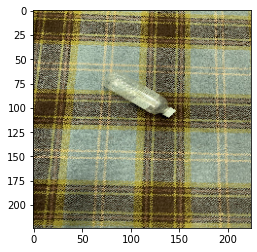

This is PET : PET971.jpg


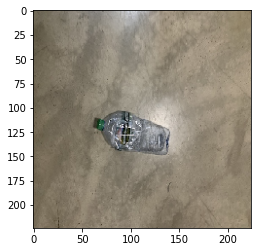

This isGlass : PET864.jpg


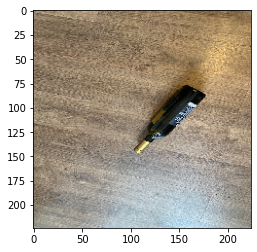

This isGlass : Glass930.JPG


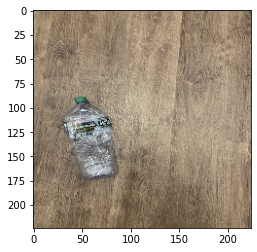

This is PET : PET909.jpg


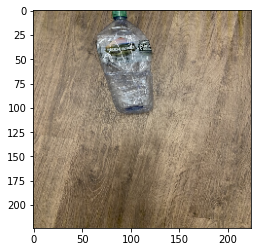

This isGlass : PET907.jpg


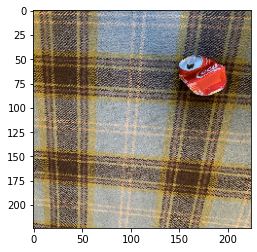

This is AluCan : AluCan972.jpg


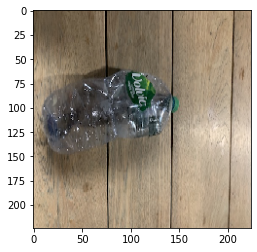

This is AluCan : PET856.jpg


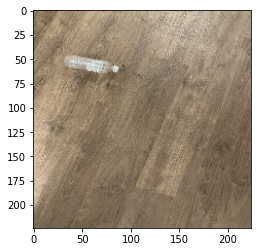

This isGlass : PET947.jpg


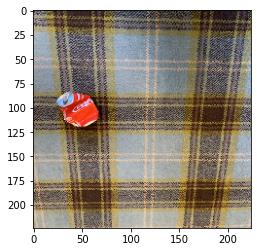

This is AluCan : AluCan976.jpg


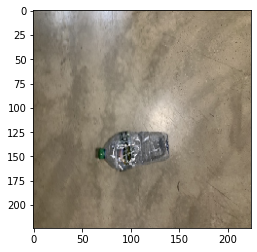

This isGlass : PET865.jpg


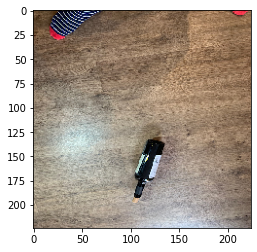

This isGlass : Glass951.JPG


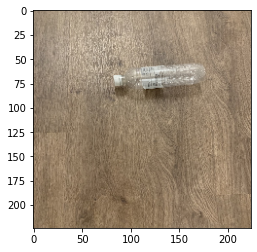

This isGlass : PET959.jpg


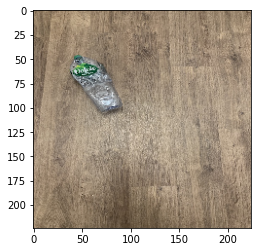

This isGlass : PET934.jpg


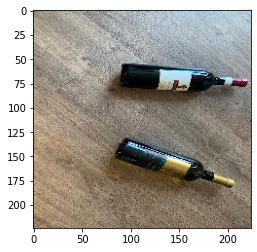

This isGlass : Glass949.JPG


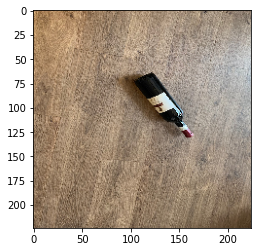

This isGlass : Glass913.JPG


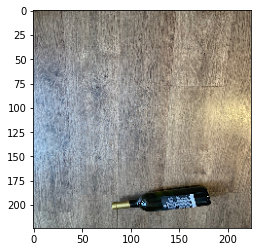

This isGlass : Glass875.JPG


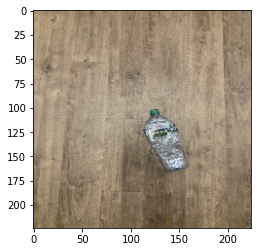

This isGlass : PET921.jpg


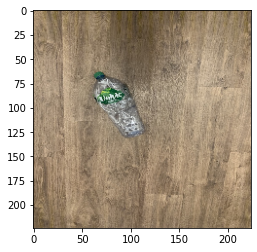

This isGlass : PET924.jpg


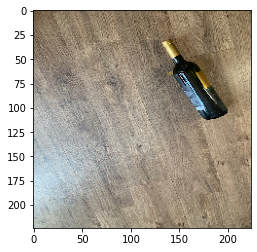

This isGlass : Glass894.JPG


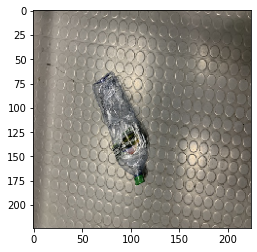

This isGlass : PET892.jpg


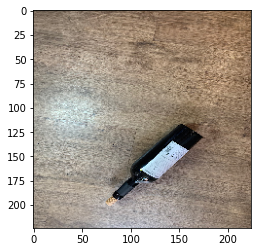

This isGlass : Glass972.JPG


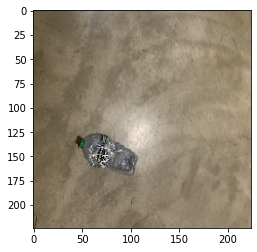

This is AluCan : PET871.jpg


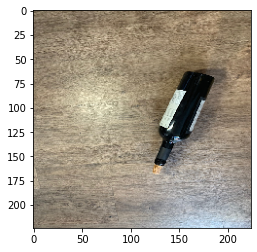

This isGlass : Glass987.JPG


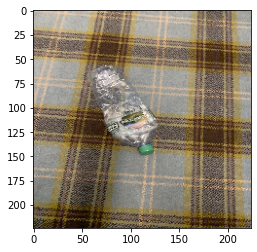

This is AluCan : PET990.jpg


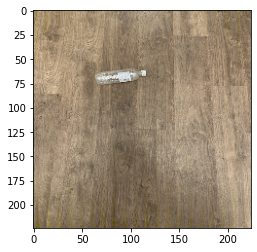

This isGlass : PET941.jpg


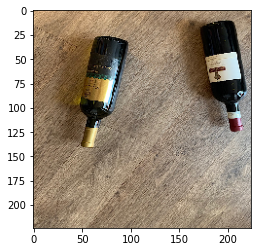

This isGlass : Glass939.JPG


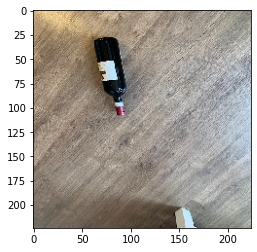

This isGlass : Glass925.JPG


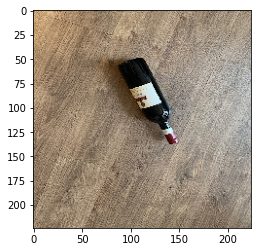

This isGlass : Glass942.JPG


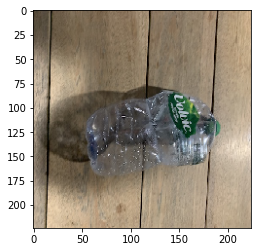

This is AluCan : PET859.jpg


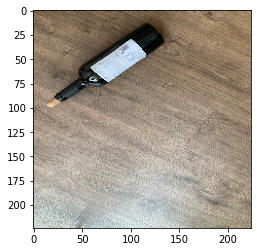

This isGlass : Glass947.JPG


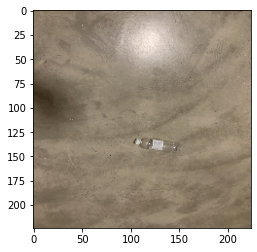

This isGlass : PET888.jpg


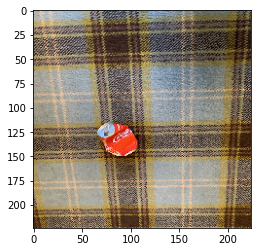

This is AluCan : AluCan969.jpg


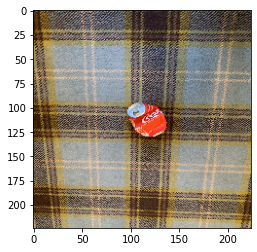

This is AluCan : AluCan970.jpg


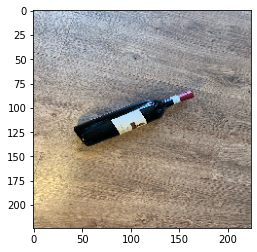

This isGlass : Glass916.JPG


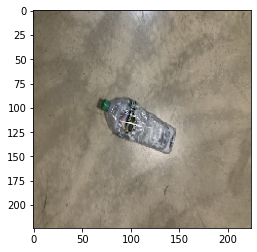

This isGlass : PET863.jpg


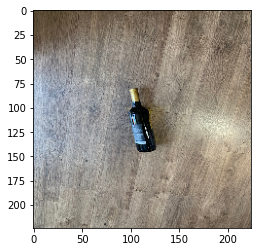

This isGlass : Glass886.JPG


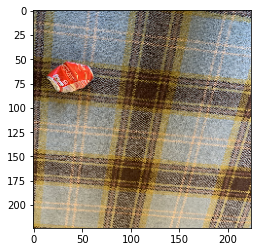

This is AluCan : AluCan998.jpg


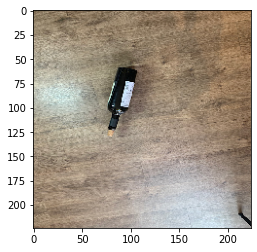

This isGlass : Glass977.JPG


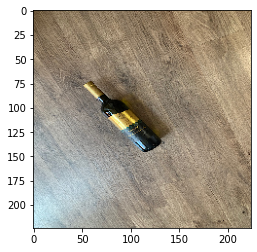

This isGlass : Glass891.JPG


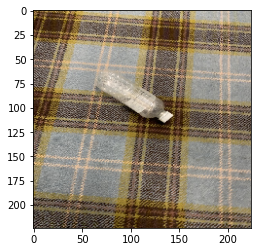

This isGlass : PET979.jpg


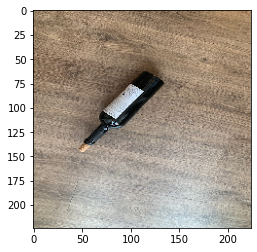

This isGlass : Glass958.JPG


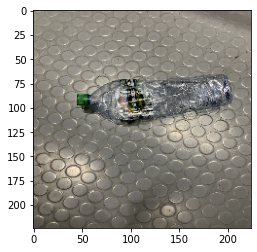

This isGlass : PET897.jpg


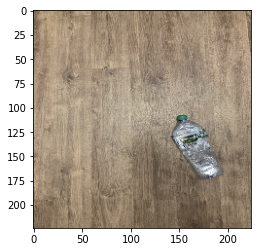

This isGlass : PET920.jpg


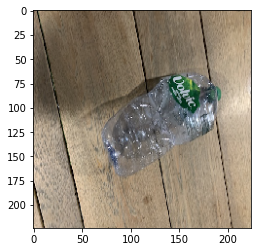

This is PET : PET852.jpg


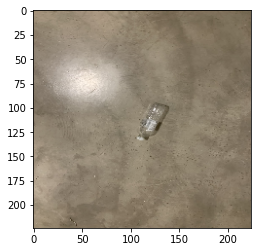

This isGlass : PET891.jpg


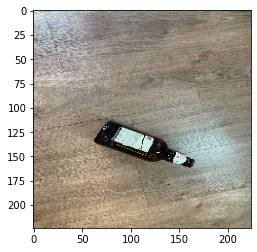

This isGlass : Glass995.JPG


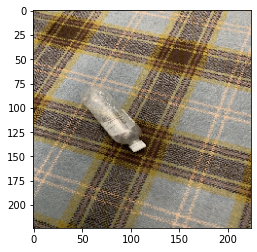

This isGlass : PET984.jpg


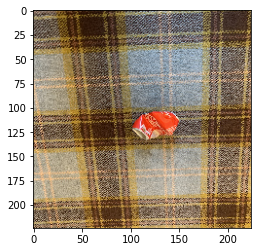

This is AluCan : AluCan991.jpg


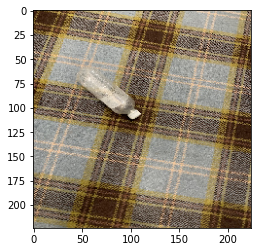

This isGlass : PET973.jpg


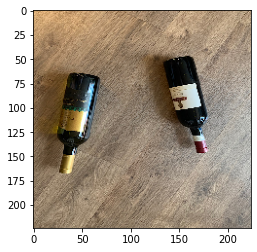

This isGlass : Glass943.JPG


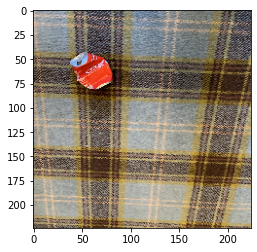

This is AluCan : AluCan974.jpg


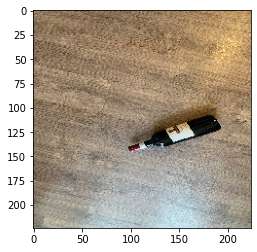

This isGlass : Glass921.JPG


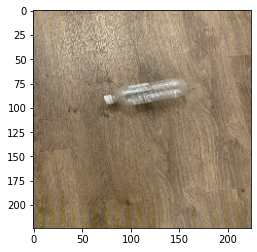

This isGlass : PET956.jpg


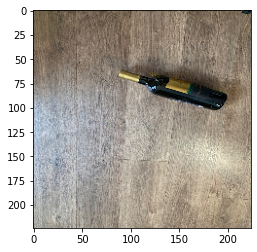

This isGlass : Glass889.JPG


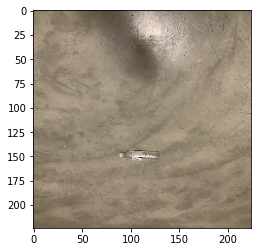

This isGlass : PET885.jpg


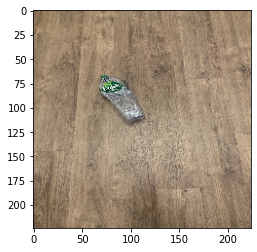

This isGlass : PET932.jpg


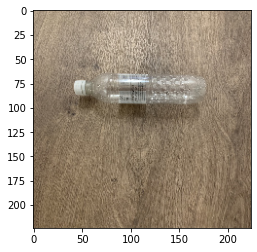

This isGlass : PET969.jpg


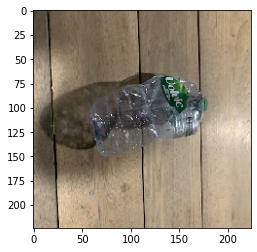

This is AluCan : PET854.jpg


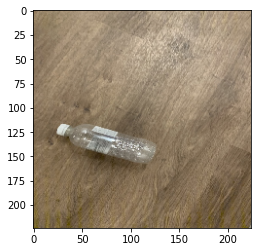

This isGlass : PET962.jpg


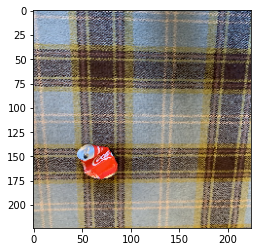

This is AluCan : AluCan988.jpg


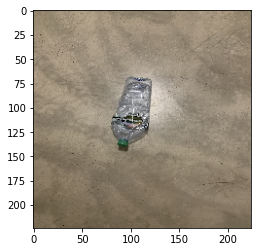

This isGlass : PET874.jpg


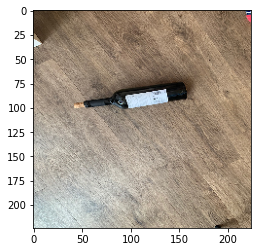

This isGlass : Glass948.JPG


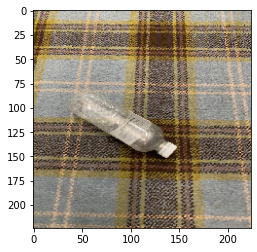

This isGlass : PET985.jpg


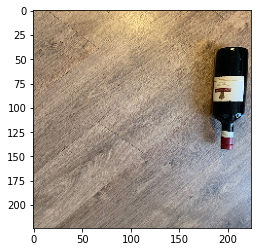

This isGlass : Glass915.JPG


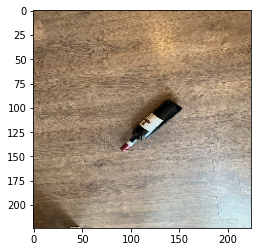

This isGlass : Glass918.JPG


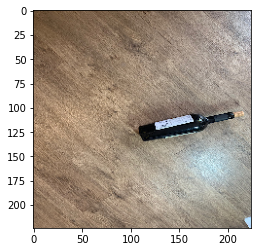

This isGlass : Glass954.JPG


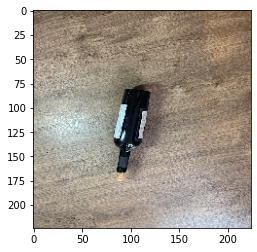

This isGlass : Glass985.JPG


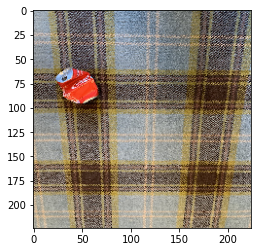

This is AluCan : AluCan986.jpg


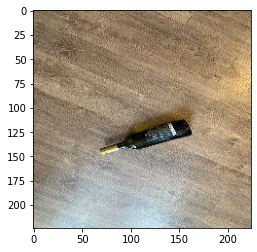

This isGlass : Glass936.JPG


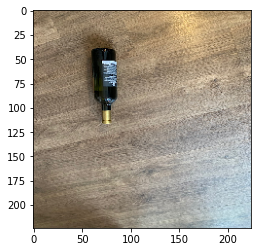

This isGlass : Glass932.JPG


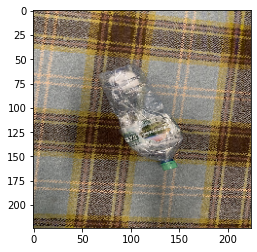

This is AluCan : PET994.jpg


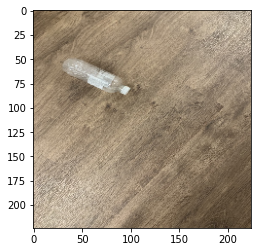

This isGlass : PET949.jpg


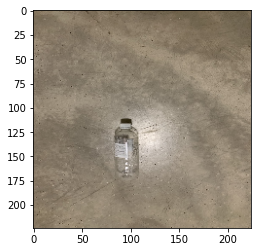

This isGlass : PET879.jpg


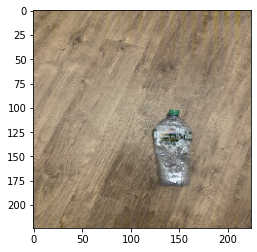

This isGlass : PET912.jpg


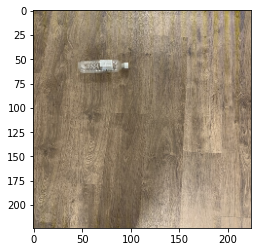

This isGlass : PET945.jpg


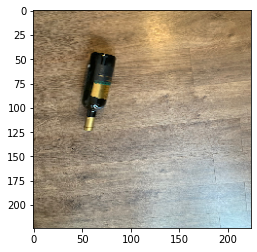

This isGlass : Glass931.JPG


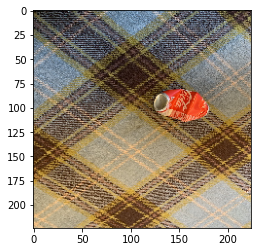

This is AluCan : AluCan992.jpg


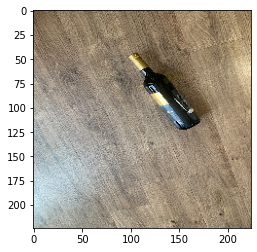

This isGlass : Glass893.JPG


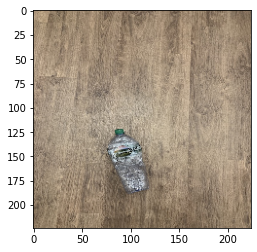

This isGlass : PET922.jpg


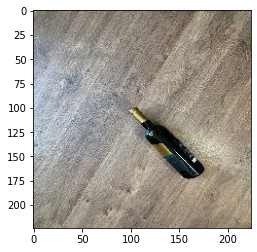

This isGlass : Glass905.JPG


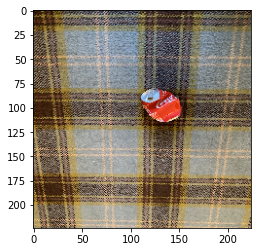

This is AluCan : AluCan983.jpg


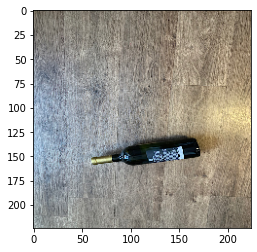

This isGlass : Glass873.JPG


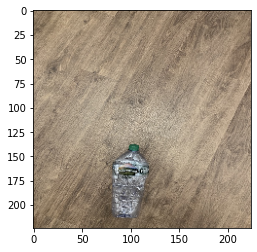

This isGlass : PET923.jpg


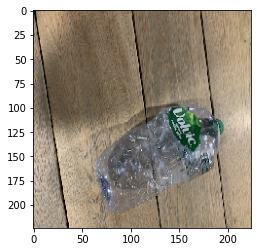

This is AluCan : PET851.jpg


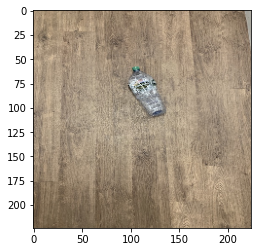

This isGlass : PET916.jpg


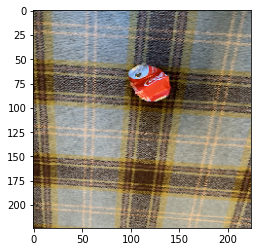

This is AluCan : AluCan973.jpg


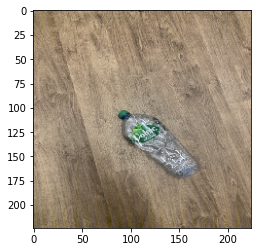

This isGlass : PET939.jpg


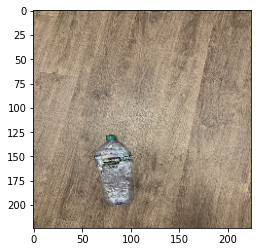

This isGlass : PET917.jpg


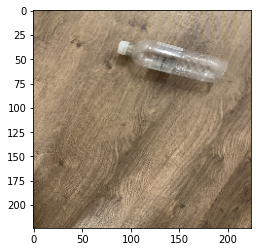

This isGlass : PET965.jpg


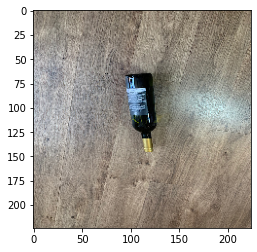

This isGlass : Glass897.JPG


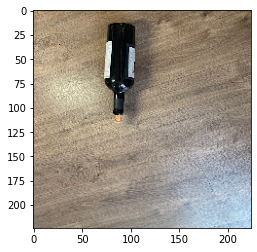

This isGlass : Glass994.JPG


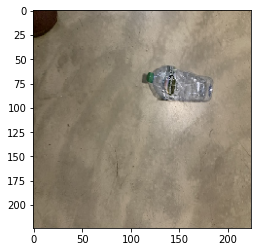

This isGlass : PET866.jpg


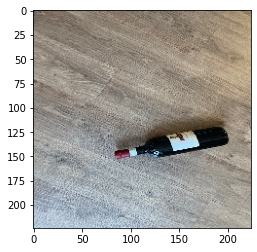

This isGlass : Glass908.JPG


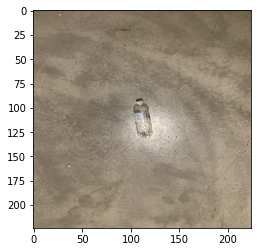

This isGlass : PET877.jpg


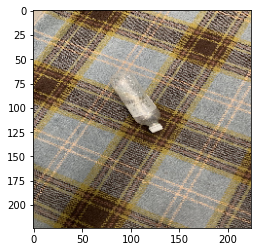

This isGlass : PET974.jpg


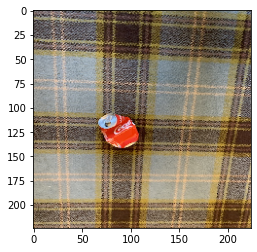

This is AluCan : AluCan982.jpg


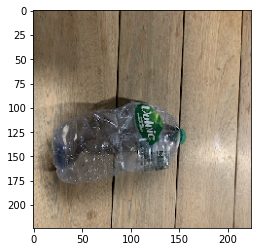

This is AluCan : PET855.jpg


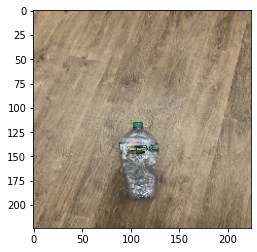

This isGlass : PET911.jpg


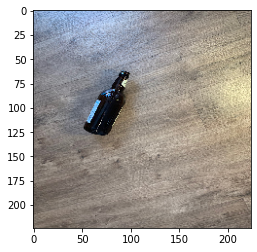

This isGlass : Glass999.JPG


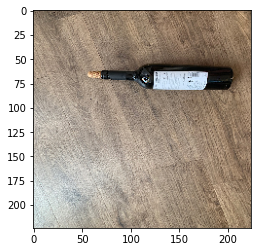

This isGlass : Glass964.JPG


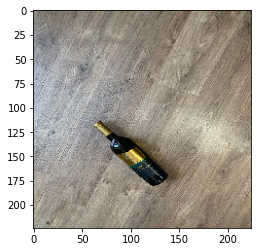

This isGlass : Glass904.JPG


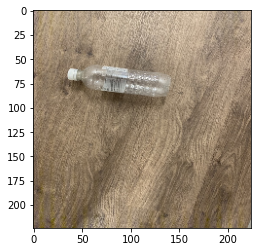

This isGlass : PET966.jpg


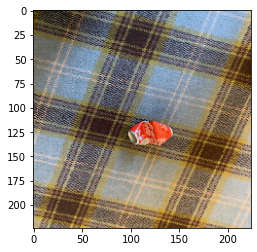

This is AluCan : AluCan993.jpg


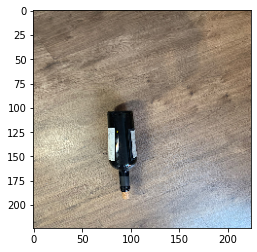

This isGlass : Glass990.JPG


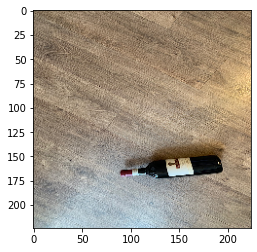

This isGlass : Glass922.JPG


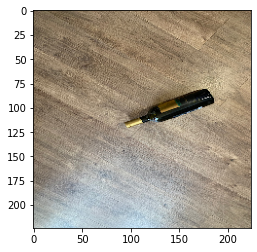

This isGlass : Glass901.JPG


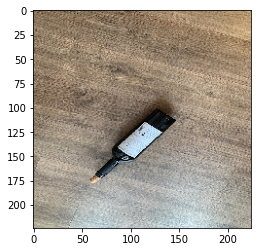

This isGlass : Glass960.JPG


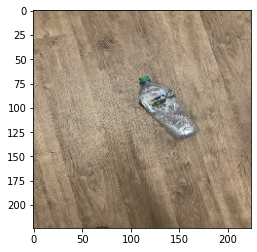

This isGlass : PET914.jpg


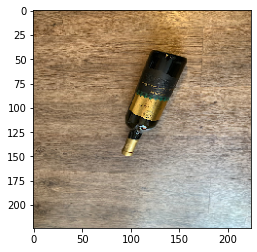

This isGlass : Glass929.JPG


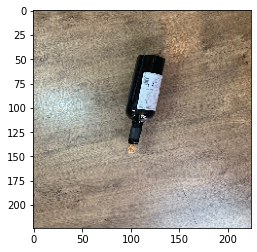

This isGlass : Glass974.JPG


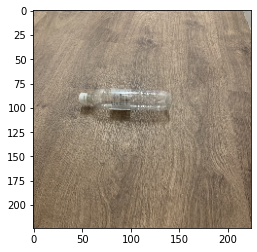

This isGlass : PET970.jpg


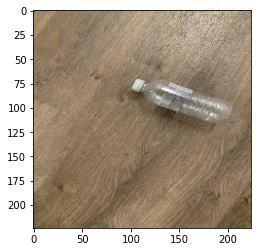

This isGlass : PET964.jpg


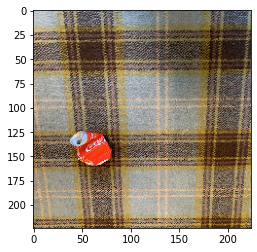

This is AluCan : AluCan968.jpg


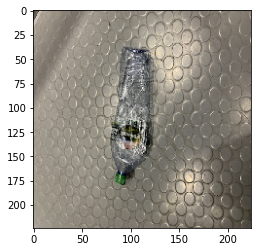

This isGlass : PET894.jpg


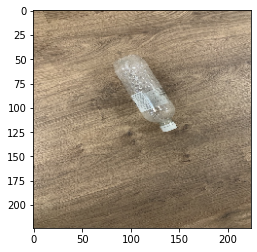

This isGlass : PET954.jpg


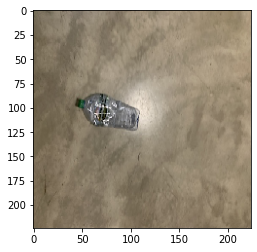

This isGlass : PET870.jpg


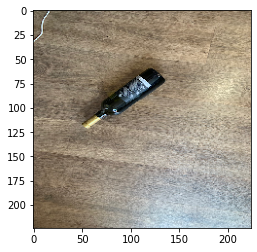

This isGlass : Glass900.JPG


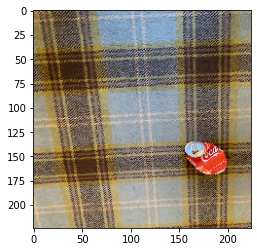

This is AluCan : AluCan980.jpg


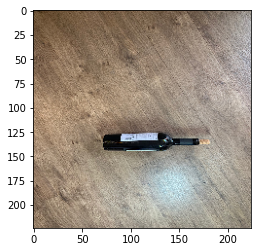

This isGlass : Glass955.JPG


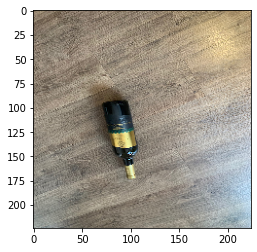

This isGlass : Glass933.JPG


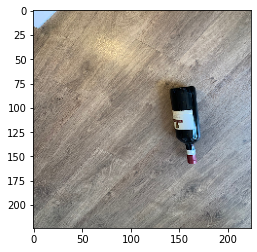

This isGlass : Glass926.JPG


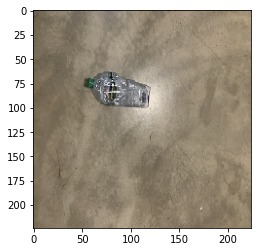

This isGlass : PET869.jpg


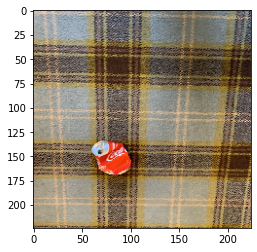

This is AluCan : AluCan967.jpg


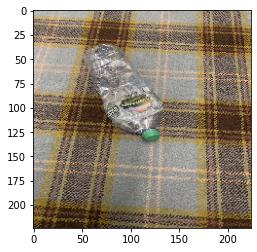

This is AluCan : PET999.jpg


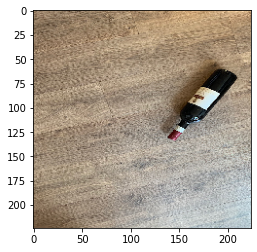

This isGlass : Glass912.JPG


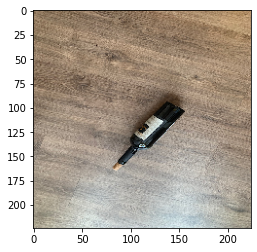

This isGlass : Glass959.JPG


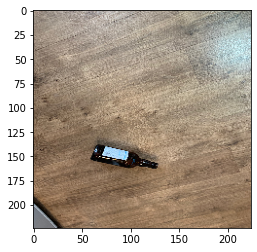

This isGlass : Glass997.JPG


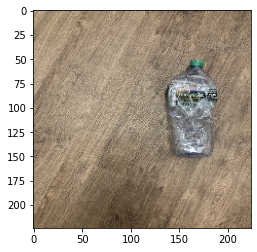

This isGlass : PET906.jpg


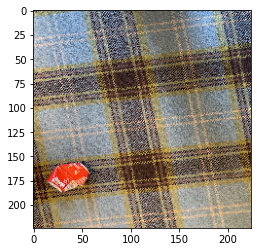

This isGlass : AluCan997.jpg


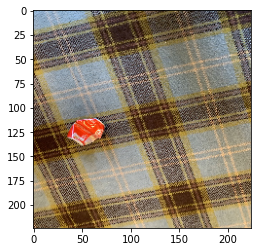

This is AluCan : AluCan996.jpg


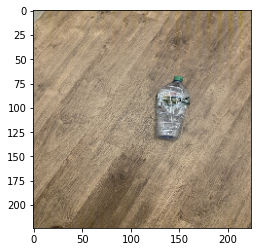

This isGlass : PET905.jpg


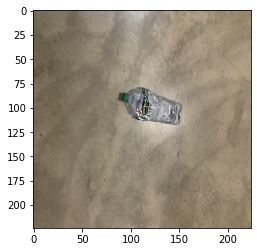

This isGlass : PET868.jpg


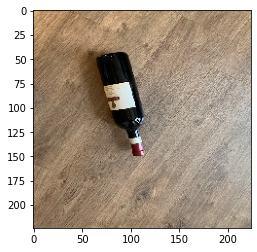

This isGlass : Glass940.JPG


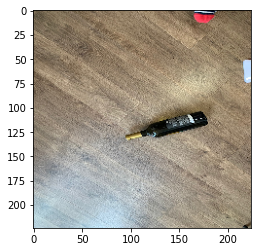

This isGlass : Glass902.JPG


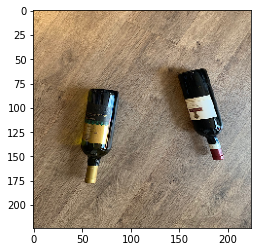

This isGlass : Glass941.JPG


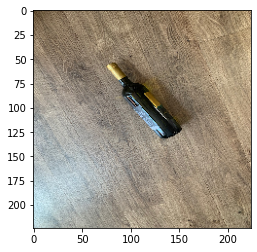

This isGlass : Glass892.JPG


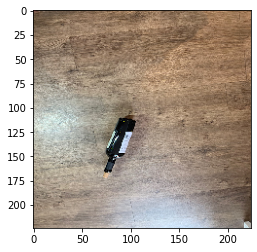

This isGlass : Glass982.JPG


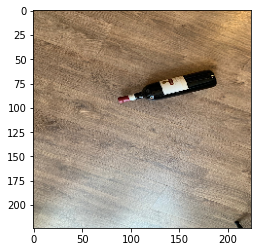

This isGlass : Glass920.JPG


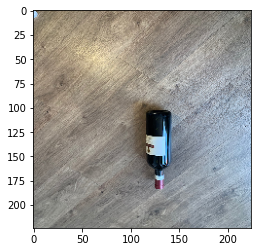

This isGlass : Glass927.JPG


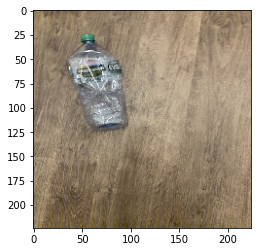

This is PET : PET908.jpg


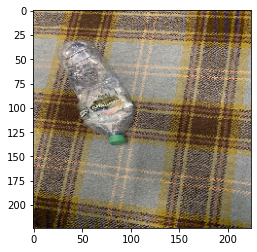

This is AluCan : PET992.jpg


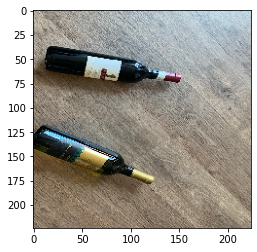

This isGlass : Glass950.JPG


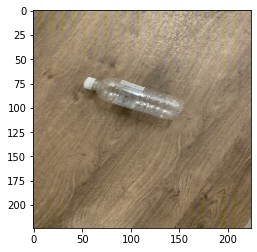

This isGlass : PET963.jpg


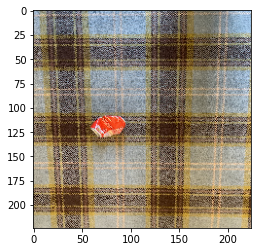

This is AluCan : AluCan995.jpg


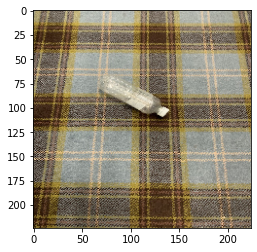

This isGlass : PET972.jpg


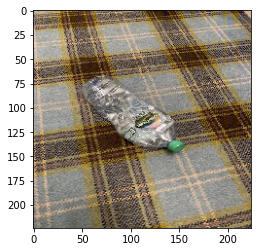

This isGlass : PET988.jpg


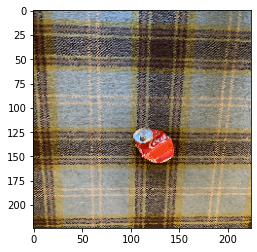

This is AluCan : AluCan981.jpg


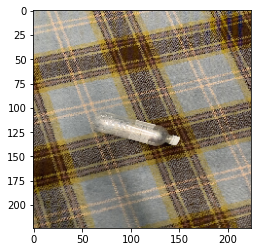

This isGlass : PET977.jpg


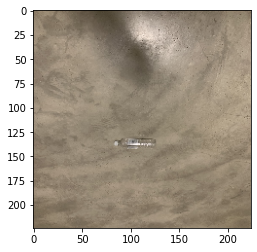

This isGlass : PET884.jpg


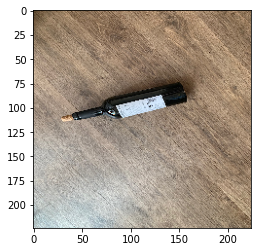

This isGlass : Glass961.JPG


In [32]:
dir_path = '/content/drive/MyDrive/dataset/Images_of_Waste/test'
for i in os.listdir(dir_path):
    img = tf.keras.preprocessing.image.load_img(dir_path+'//'+i, target_size=(224,224))
    plt.imshow(img)
    plt.show()

    X= tf.keras.preprocessing.image.img_to_array(img)
    X= np.expand_dims(X,axis=0)
    image = np.vstack([X])
    val = model.predict(image)
    '''print(val)
    print(val[0][0])
    print(val[0][1])
    print(val[0][2])
    print(np.argmax(val)) '''

    if val[0][0] > val[0][1] and val[0][0] > val[0][2] :
        print('This is AluCan : '+i)
    
    elif val[0][1] > val[0][0] and val[0][1] > val[0][2] :
        print('This isGlass : '+i)

    elif val[0][2] > val[0][0] and val[0][2] > val[0][1] :
        print('This is PET : '+i)